# Refine tangram annotations using clustering for tonsil_s0

In [1]:
slide_id = "tonsil_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_78182/4156079343.py:1: DeprecationWarning: Table group found in zarr store at location /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_tonsil_s0.zarr. Please update the zarr storeto use tables instead.
  sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")


SpatialData object with:
├── Images
│     └── 'he': MultiscaleSpatialImage[cyx] (3, 41995, 31469), (3, 20998, 15735)
├── Points
│     └── 'st': DataFrame with shape: (91956825, 10) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (1349620, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (1349620, 541)
with coordinate systems:
▸ '_st_intrinsic', with elements:
        st (Points)
▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_78182/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 1349620 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,24.948997,Tonsillar crypt
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,7.315320,Naive CD8 T
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,18.265802,Naive CD8 T
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,12.598752,cDC2
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,12.621283,Granulocyte
...,...,...,...,...,...
aabejhop-1,nucleus_boundaries,morpho,aabejhop-1,20.522395,Pre-B cell
aabejhpa-1,nucleus_boundaries,morpho,aabejhpa-1,36.082324,Macrophage
aabejhpb-1,nucleus_boundaries,morpho,aabejhpb-1,51.502550,Macrophage
aabejhpc-1,nucleus_boundaries,morpho,aabejhpc-1,7.472094,Memory B precursor


In [6]:
adata_ini.var

""
ABCC11
ACE2
ACKR1
ACTA2
ACTG2
...
UnassignedCodeword_0499
VCAN
VSIG4
VWA5A


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,24.948997,Tonsillar crypt,70
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,7.315320,Naive CD8 T,25
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,18.265802,Naive CD8 T,35
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,12.598752,cDC2,22
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,12.621283,Granulocyte,20
...,...,...,...,...,...,...
aabejhop-1,nucleus_boundaries,morpho,aabejhop-1,20.522395,Pre-B cell,89
aabejhpa-1,nucleus_boundaries,morpho,aabejhpa-1,36.082324,Macrophage,113
aabejhpb-1,nucleus_boundaries,morpho,aabejhpb-1,51.502550,Macrophage,127
aabejhpc-1,nucleus_boundaries,morpho,aabejhpc-1,7.472094,Memory B precursor,7


<Axes: >

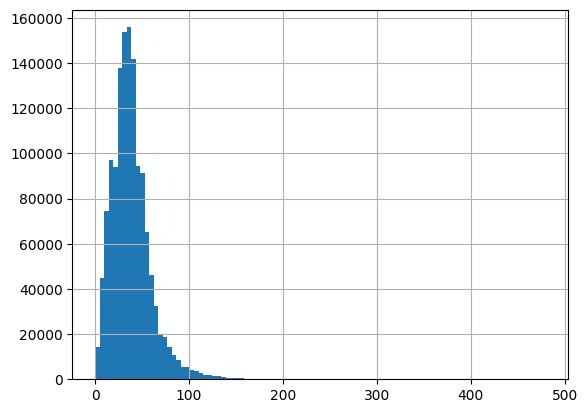

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

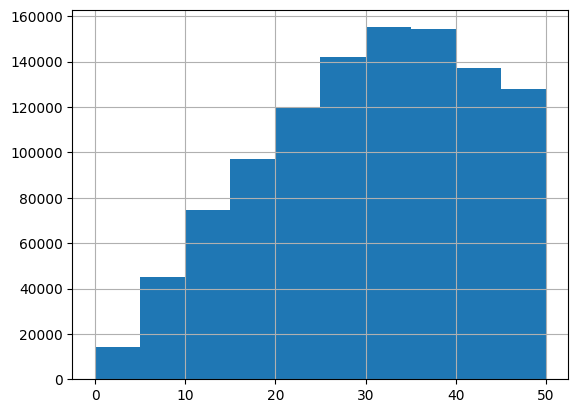

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 230904
Percentage of cells with less than 20 transcripts: 17.11%
-----
Number of cells with less than 15 transcripts: 133689
Percentage of cells with less than 15 transcripts: 9.91%
-----
Number of cells with less than 10 transcripts: 59137
Percentage of cells with less than 10 transcripts: 4.38%
-----
Number total of cells: 1349620


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

1277643


In [12]:
# Save the raw data
adata.layers['count'] = adata.X.copy()

In [13]:
# Normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()

In [14]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [15]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


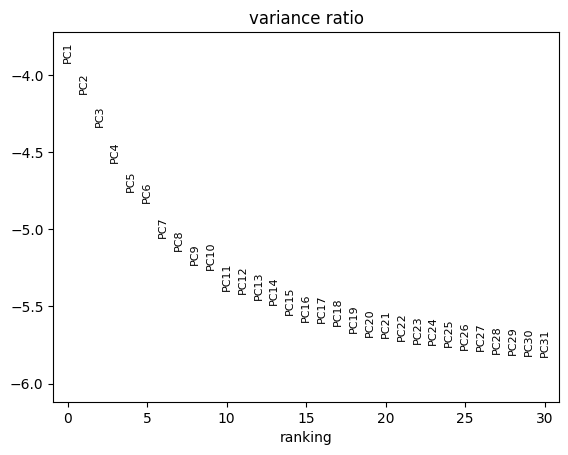

In [16]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata, log=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 1277643 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts'
    var: 'mean', 'std'
    uns: 'sopa_attrs', 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'tangram_pred', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [18]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [19]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_78182/2486232371.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


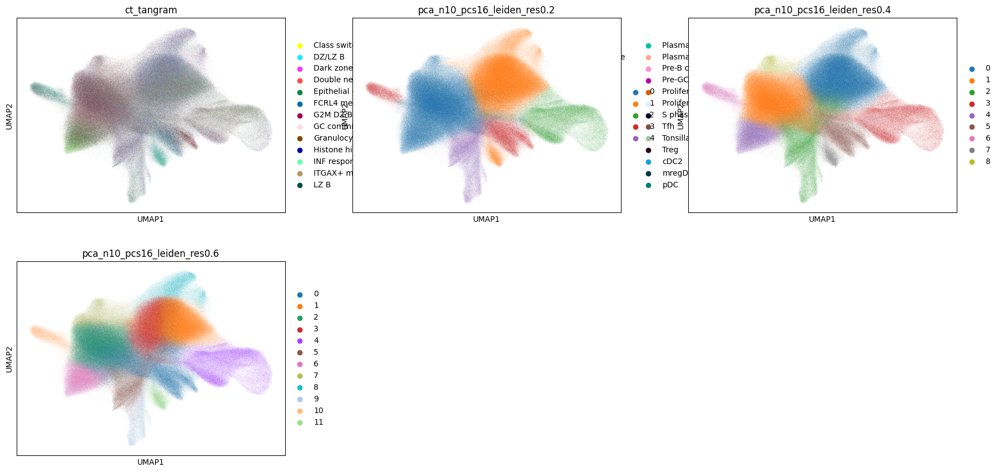

In [20]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3)

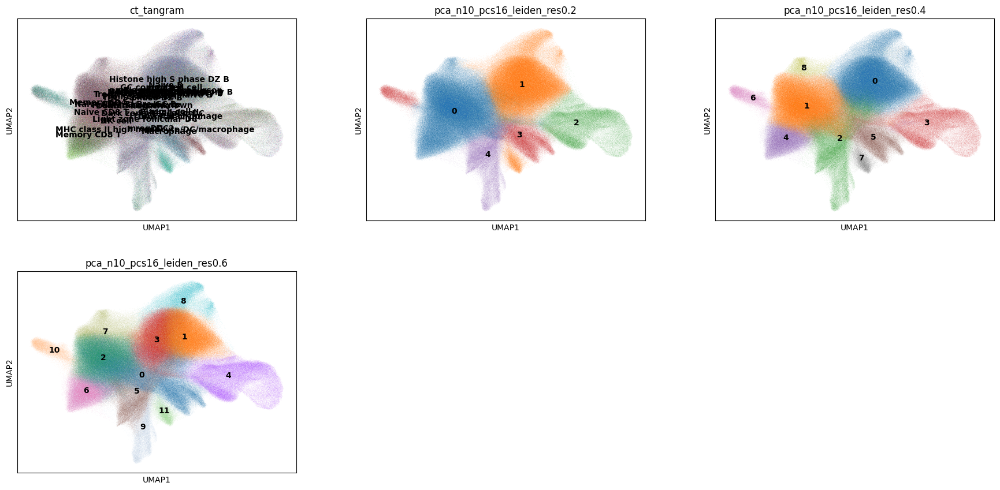

In [21]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

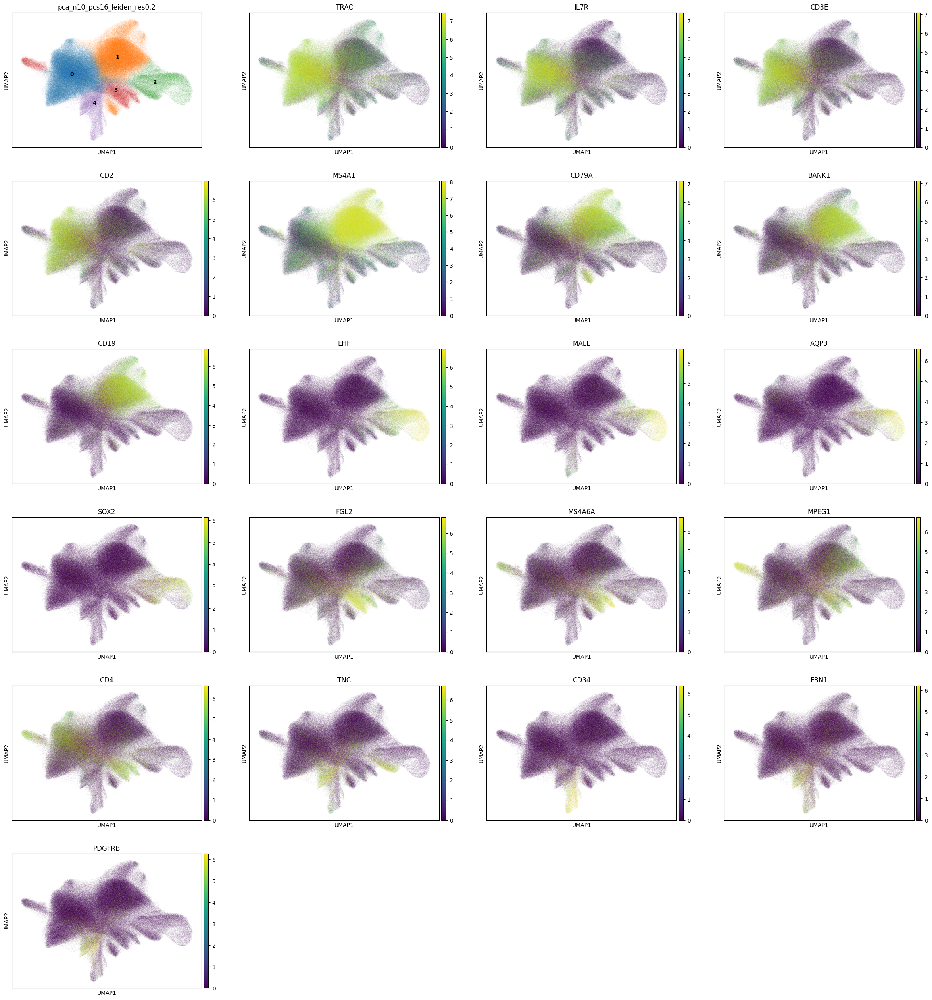

In [22]:
clustering_label = 'pca_n10_pcs16_leiden_res0.2'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

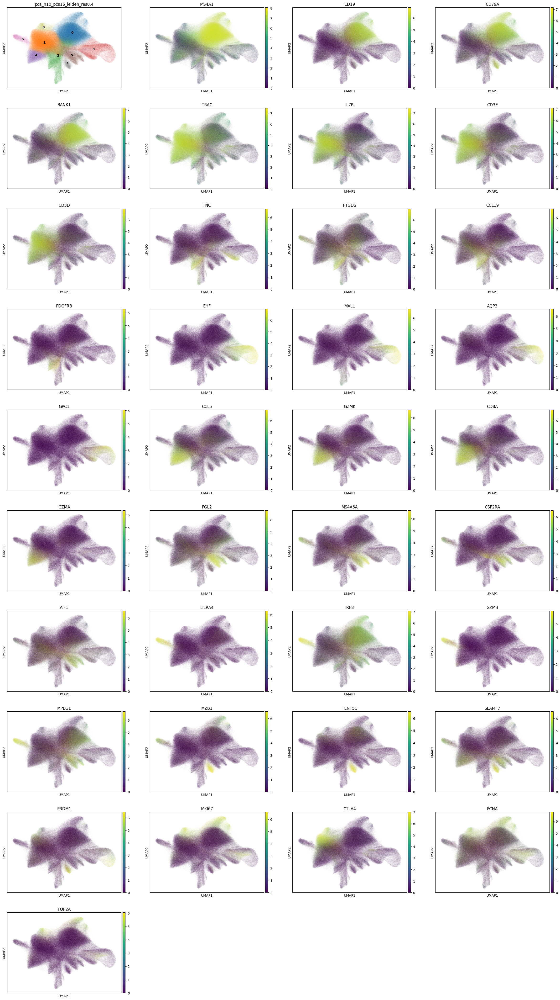

In [23]:
clustering_label = 'pca_n10_pcs16_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [24]:
# Number of clusters
adata.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['8', '2', '1', '7', '4', '0', '5', '6', '3']
Categories (9, object): ['0', '1', '2', '3', ..., '5', '6', '7', '8']

In [25]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '9'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '10'

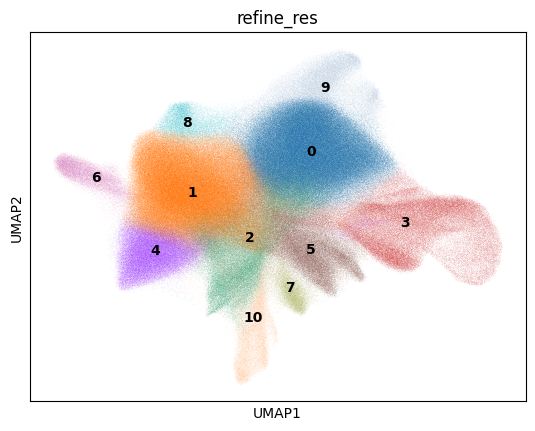

In [26]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [27]:
clustering_label = 'refine_res'

In [28]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_78182/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


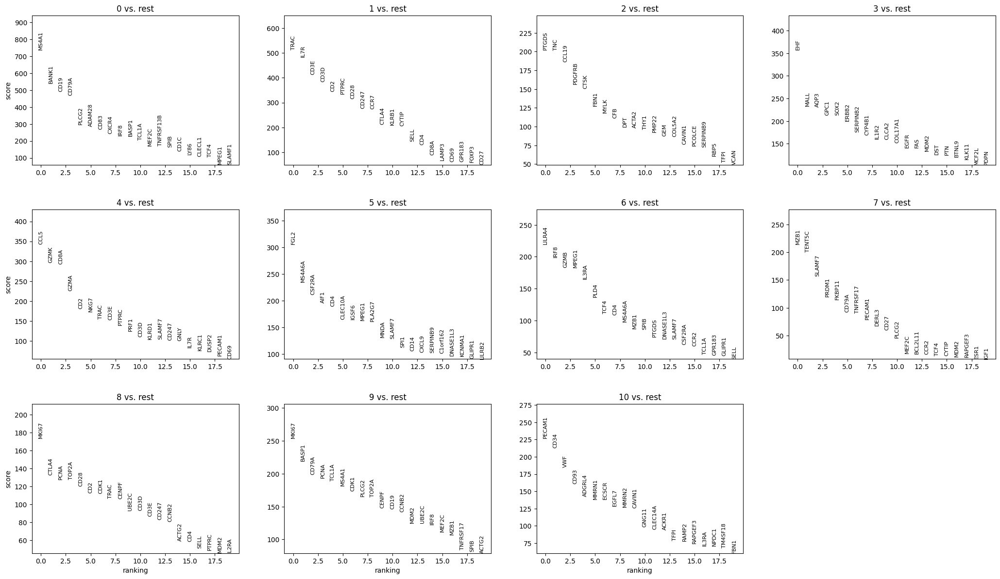

In [29]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [30]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [31]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [32]:
cluster_id = '0'

In [33]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,Naive B,10
1,0,Class switch memory B,6
2,0,Non-class switch memory B,5
3,0,FCRL4 memory B,5
4,0,Memory B precursor,4
5,0,GC committed cell,4
6,0,Proliferation unknown,4


In [34]:
top_ranked_genes[cluster_id]

0    MS4A1
1    BANK1
2     CD19
3    CD79A
4    PLCG2
Name: 0, dtype: object

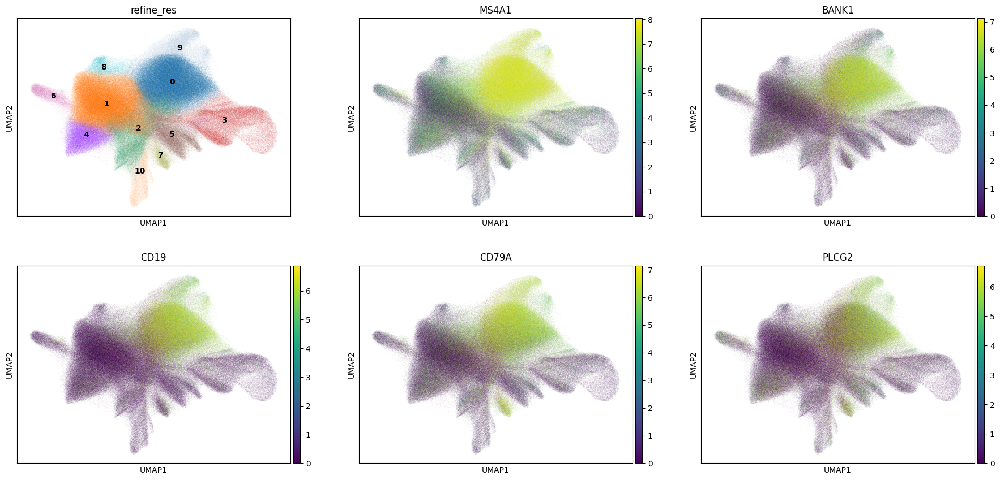

In [35]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [36]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 351885
Percentage of cells in cluster 0: 27.5


In [37]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.2. Cluster 1

In [38]:
cluster_id = '1'

In [39]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,Naive CD4 T,8
8,1,Memory CD4 T,8
9,1,Naive CD8 T,7
10,1,Tfh,7
11,1,Proliferation unknown,5
12,1,Treg,5
13,1,mregDC,4


In [40]:
top_ranked_genes[cluster_id]

0    TRAC
1    IL7R
2    CD3E
3    CD3D
4     CD2
Name: 1, dtype: object

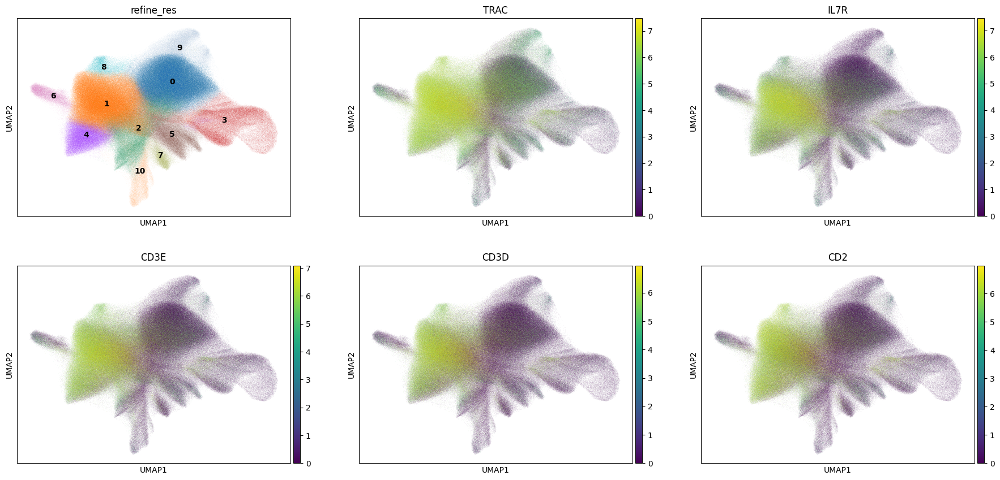

In [41]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [42]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 380092
Percentage of cells in cluster 1: 29.7


In [43]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.3. Cluster 2

In [106]:
cluster_id = '2'

In [45]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,Light zone follicular DC,10
15,2,mregDC,9
16,2,Macrophage,9
17,2,Proliferation unknown,8
18,2,Dark zone follicular DC,5
19,2,cDC2,4
20,2,Pre-GC B,4


In [46]:
top_ranked_genes[cluster_id]

0     PTGDS
1       TNC
2     CCL19
3    PDGFRB
4      CTSK
Name: 2, dtype: object

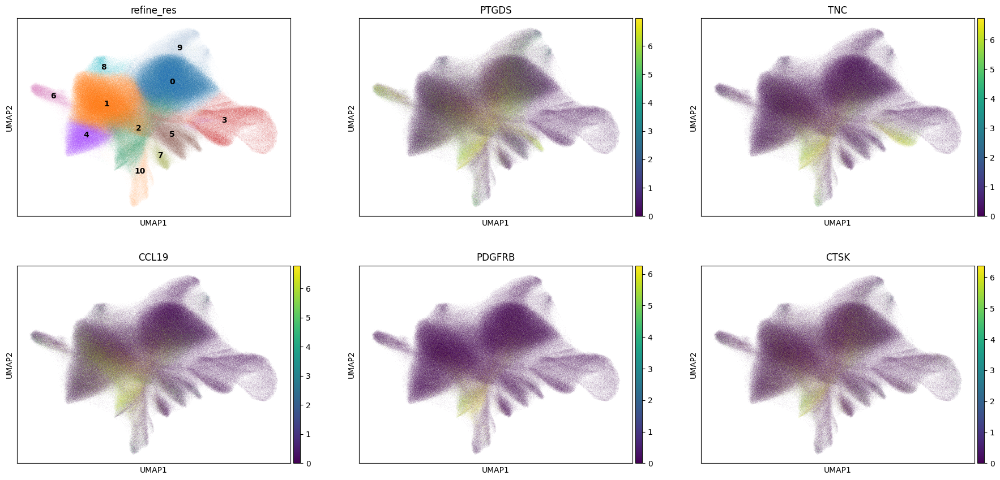

In [47]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [48]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 114344
Percentage of cells in cluster 2: 8.9


In [107]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'DC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Follicular_DC'

### 5.4. Cluster 3

In [50]:
cluster_id = '3'

In [51]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,ITGAX+ macrophage,14
22,3,Tonsillar crypt,10
23,3,Epithelial cell,9
24,3,Macrophage,8
25,3,mregDC,6
26,3,cDC2,6
27,3,Pre-GC B,6


In [52]:
top_ranked_genes[cluster_id]

0     EHF
1    MALL
2    AQP3
3    GPC1
4    SOX2
Name: 3, dtype: object

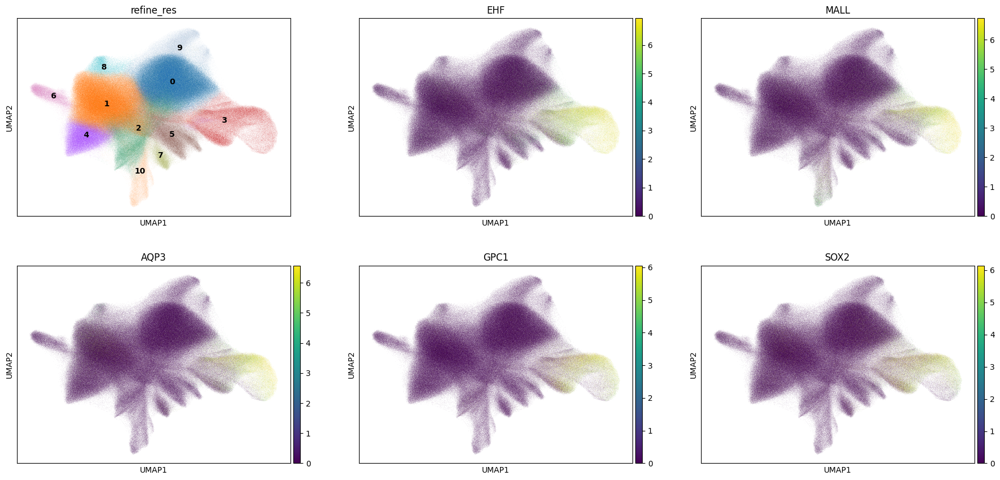

In [53]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [54]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 111581
Percentage of cells in cluster 3: 8.7


In [55]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Epithelial'

### 5.5. Cluster 4

In [56]:
cluster_id = '4'

In [57]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,Memory CD8 T,30
29,4,NK cell,17
30,4,Naive CD8 T,5
31,4,Proliferation unknown,4
32,4,mregDC,4
33,4,Pre-GC B,4
34,4,Macrophage,3


In [58]:
top_ranked_genes[cluster_id]

0    CCL5
1    GZMK
2    CD8A
3    GZMA
4     CD2
Name: 4, dtype: object

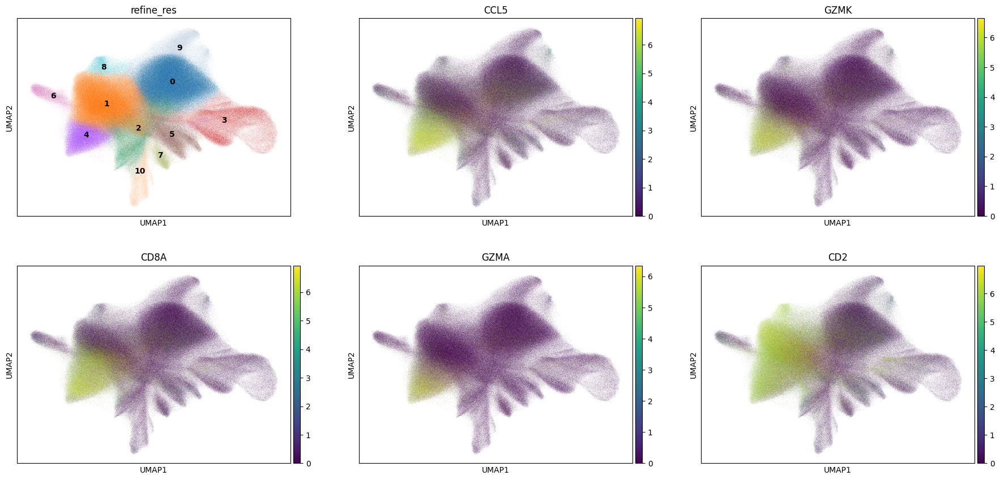

In [59]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [60]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 93772
Percentage of cells in cluster 4: 7.3


In [61]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.6. Cluster 5

In [62]:
cluster_id = '5'

In [63]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,Macrophage,29
36,5,cDC2,21
37,5,mregDC,11
38,5,MHC class II high monocyte/DC/macrophage,10
39,5,ITGAX+ macrophage,5
40,5,pDC,3
41,5,Pre-GC B,2


In [64]:
top_ranked_genes[cluster_id]

0      FGL2
1    MS4A6A
2    CSF2RA
3      AIF1
4       CD4
Name: 5, dtype: object

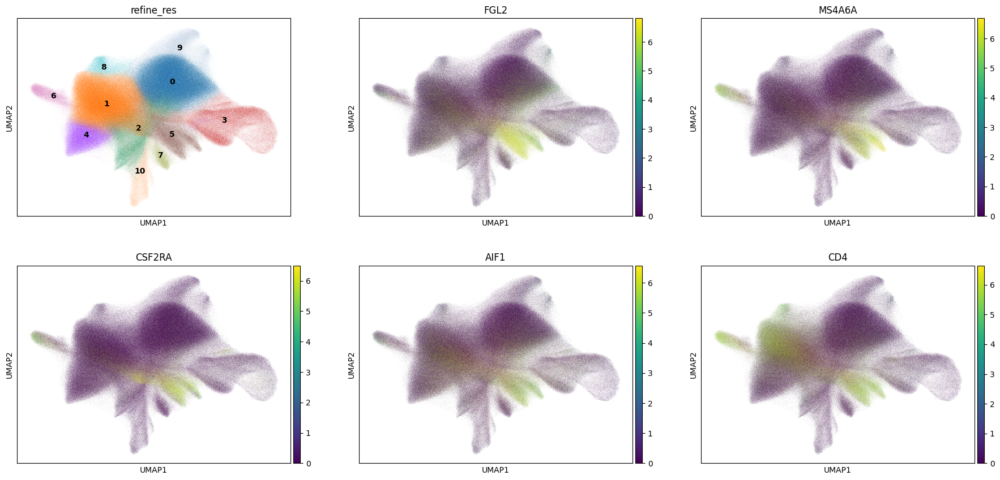

In [65]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [66]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 81199
Percentage of cells in cluster 5: 6.4


In [67]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.7. Cluster 6

In [68]:
cluster_id = '6'

In [69]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,pDC,50
43,6,Macrophage,10
44,6,mregDC,5
45,6,cDC2,4
46,6,Proliferation unknown,4
47,6,NK cell,3
48,6,Pre-GC B,3


In [70]:
top_ranked_genes[cluster_id]

0    LILRA4
1      IRF8
2      GZMB
3     MPEG1
4     IL3RA
Name: 6, dtype: object

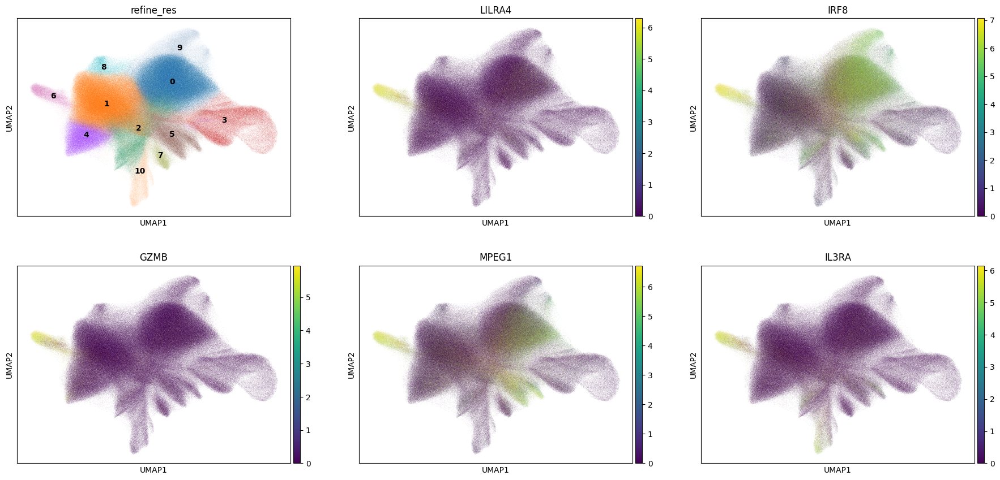

In [71]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [72]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 29031
Percentage of cells in cluster 6: 2.3


In [73]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'pDC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'pDC'

### 5.8. Cluster 7

In [74]:
cluster_id = '7'

In [75]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,Plasma cell,49
50,7,Proliferation unknown,5
51,7,cDC2,3
52,7,mregDC,3
53,7,ITGAX+ macrophage,3
54,7,Double negative T,3
55,7,NK cell,3


In [76]:
top_ranked_genes[cluster_id]

0      MZB1
1    TENT5C
2    SLAMF7
3     PRDM1
4    FKBP11
Name: 7, dtype: object

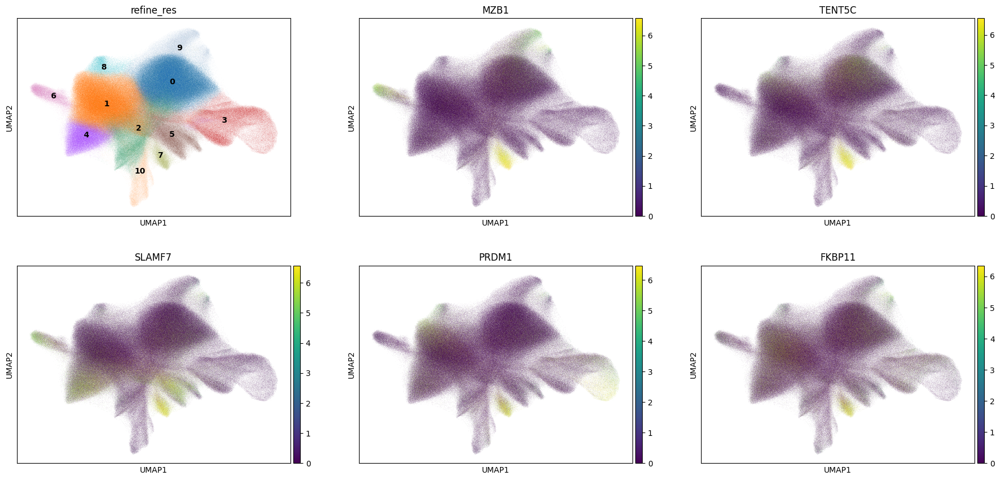

In [77]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [78]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 22546
Percentage of cells in cluster 7: 1.8


In [79]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.9. Cluster 8

In [80]:
cluster_id = '8'

In [81]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Tfh,14
57,8,Naive CD4 T,10
58,8,Proliferation T,6
59,8,Treg,6
60,8,Pre-GC B,6
61,8,Naive CD8 T,5
62,8,Memory CD4 T,5


In [82]:
top_ranked_genes[cluster_id]

0    MKI67
1    CTLA4
2     PCNA
3    TOP2A
4     CD28
Name: 8, dtype: object

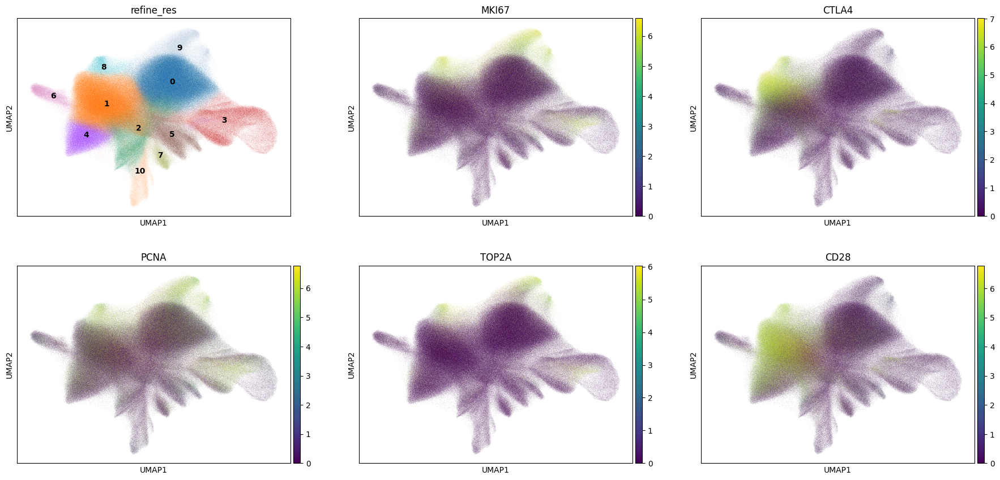

In [83]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [84]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 16927
Percentage of cells in cluster 8: 1.3


In [85]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_Treg'

### 5.10. Cluster 9

In [86]:
cluster_id = '9'

In [87]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
63,9,Histone high S phase DZ B,15
64,9,Pre-GC B,8
65,9,Proliferation unknown,6
66,9,Plasma cell,6
67,9,Proliferation T,5
68,9,Pre-B cell,4
69,9,ITGAX+ macrophage,4


In [88]:
top_ranked_genes[cluster_id]

0    MKI67
1    BASP1
2    CD79A
3     PCNA
4    TCL1A
Name: 9, dtype: object

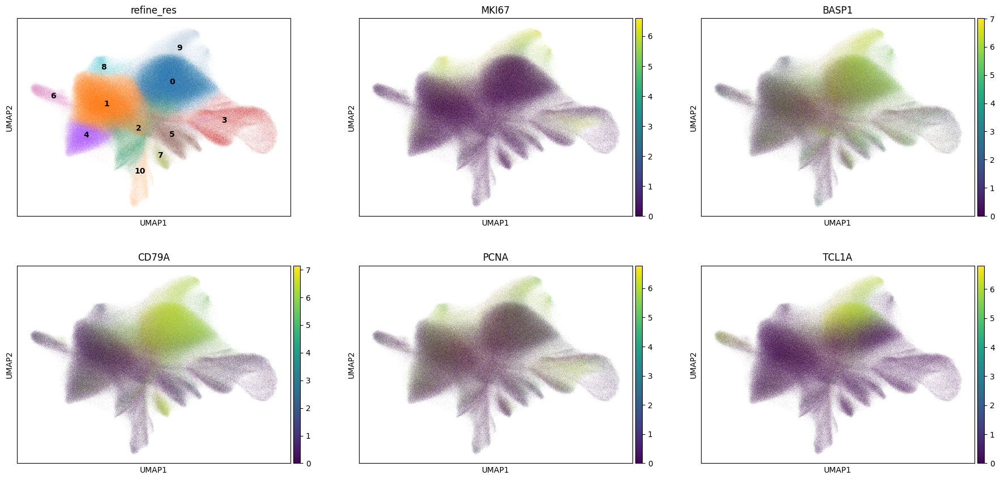

In [89]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [90]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 43593
Percentage of cells in cluster 9: 3.4


In [91]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_B'

### 5.11. Cluster 10

In [92]:
cluster_id = '10'

In [93]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
70,10,mregDC,14
71,10,Epithelial cell,10
72,10,Tonsillar crypt,9
73,10,cDC2,9
74,10,Light zone follicular DC,7
75,10,NK cell,7
76,10,ITGAX+ macrophage,4


In [94]:
top_ranked_genes[cluster_id]

0    PECAM1
1      CD34
2       VWF
3      CD93
4    ADGRL4
Name: 10, dtype: object

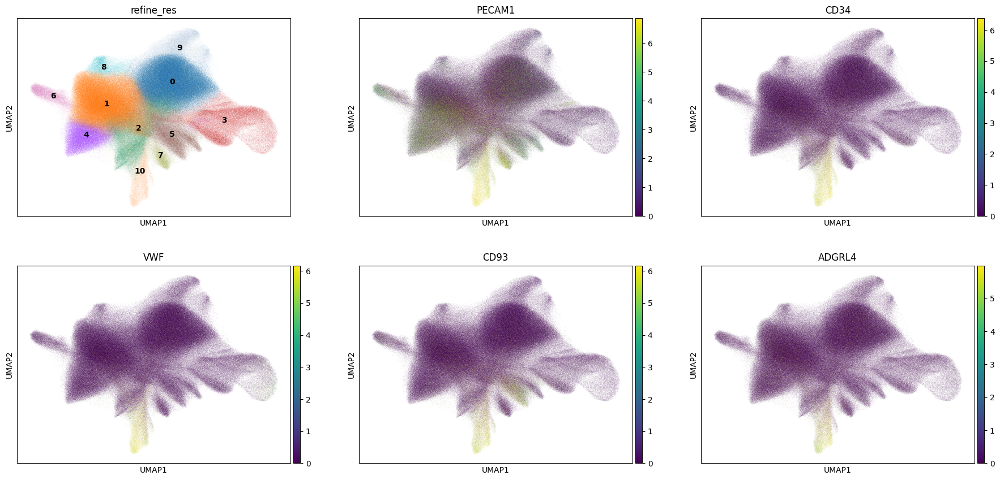

In [95]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [96]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 32673
Percentage of cells in cluster 10: 2.6


In [97]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

## 6. Cancer cells

In [108]:
adata.obs['label1'].unique()

array(['T', 'Endothelial', 'Plasma', 'DC', 'B', 'Monocyte/Macrophage/DC',
       'pDC', 'Epithelial'], dtype=object)

In [109]:
adata.obs['label2'].unique()

array(['Proliferating_Treg', 'Endothelial', 'T', 'Plasma',
       'Follicular_DC', 'T_CD8', 'B', 'Monocyte/Macrophage/DC', 'pDC',
       'Proliferating_B', 'Epithelial'], dtype=object)

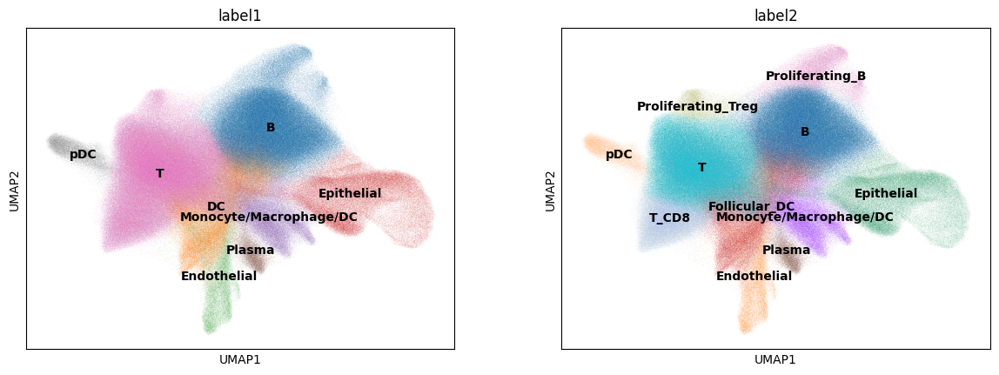

In [110]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [114]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'

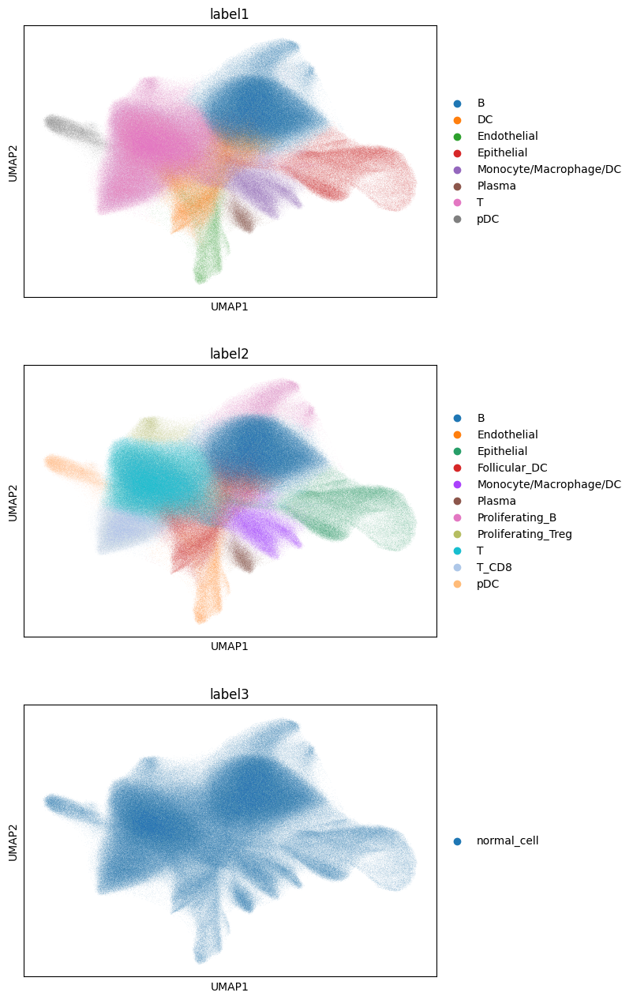

In [115]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [116]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,24.948997,Tonsillar crypt,70,0,8,7,8,T,Proliferating_Treg,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,7.315320,Naive CD8 T,25,4,2,9,10,Endothelial,Endothelial,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,18.265802,Naive CD8 T,35,0,1,0,1,T,T,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,12.598752,cDC2,22,1,7,0,7,Plasma,Plasma,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,12.621283,Granulocyte,20,4,2,9,10,Endothelial,Endothelial,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aabejhoo-1,nucleus_boundaries,morpho,aabejhoo-1,40.686362,Tonsillar crypt,115,2,3,1,3,Epithelial,Epithelial,normal_cell
aabejhop-1,nucleus_boundaries,morpho,aabejhop-1,20.522395,Pre-B cell,89,0,1,7,1,T,T,normal_cell
aabejhpa-1,nucleus_boundaries,morpho,aabejhpa-1,36.082324,Macrophage,113,2,3,4,3,Epithelial,Epithelial,normal_cell
aabejhpb-1,nucleus_boundaries,morpho,aabejhpb-1,51.502550,Macrophage,127,2,3,4,3,Epithelial,Epithelial,normal_cell


In [117]:
adata.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")